# importing data and necessary libraries

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import missingno as msno

In [2]:
data=pd.read_csv('cleaned.csv')
data

ParserError: Error tokenizing data. C error: Calling read(nbytes) on source failed. Try engine='python'.

In [ ]:
from sklearn.preprocessing import LabelEncoder

In [ ]:
encoder = LabelEncoder()
data['unit_code']=encoder.fit_transform(data['quantity_name'])

In [5]:
data

,Unnamed: 0,country_or_area,year,comm_code,commodity,flow,trade_usd,weight_kg,quantity_name,quantity,category,acat_code,unit_code
0,0,Afghanistan,2016,10410,"Sheep, live",Export,1.161273e-08,1.257437e-09,Number of items,4.969031e-14,01_live_animals,0,4
1,1,Afghanistan,2016,10420,"Goats, live",Export,7.549135e-09,5.289944e-10,Number of items,5.163895e-14,01_live_animals,0,4
2,2,Afghanistan,2008,10210,"Bovine animals, live pure-bred breeding",Import,1.958927e-06,1.462261e-10,Number of items,3.672212e-12,01_live_animals,0,4
3,3,Albania,2016,10290,"Bovine animals, live, except pure-bred breeding",Import,4.606426e-06,5.988942e-07,Number of items,6.677014e-12,01_live_animals,0,4
4,4,Albania,2016,10392,"Swine, live except pure-bred breeding > 50 kg",Import,2.721645e-05,5.099072e-06,Number of items,9.357368e-11,01_live_animals,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7876278,8225123,Tunisia,1995,TOTAL,ALL COMMODITIES,Export,1.044445e-02,0.000000e+00,No Quantity,0.000000e+00,all_commodities,97,3
7876279,8225460,United Kingdom,1998,TOTAL,ALL COMMODITIES,Import,5.950014e-01,0.000000e+00,No Quantity,0.000000e+00,all_commodities,97,3
7876280,8225461,United Kingdom,1998,TOTAL,ALL COMMODITIES,Export,5.156674e-01,0.000000e+00,No Quantity,0.000000e+00,all_commodities,97,3
7876281,8225462,United Kingdom,1997,TOTAL,ALL COMMODITIES,Import,5.821351e-01,0.000000e+00,No Quantity,0.000000e+00,all_commodities,97,3


## Data exploration and visualisation

In [6]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
Unnamed: 0,7876283.0,4.032266e+06,2.341688e+06,0.0,2.000660e+06,4.022543e+06,6.044084e+06,8225463.0
year,7876283.0,2.004599e+03,7.074818e+00,1988.0,1.999000e+03,2.005000e+03,2.011000e+03,2016.0
trade_usd,7876283.0,4.305331e-05,1.723092e-03,0.0,2.171163e-08,2.986840e-07,3.636388e-06,1.0
weight_kg,7876283.0,1.957746e-05,1.350706e-03,0.0,6.123217e-10,1.515322e-08,2.509917e-07,1.0
quantity,7876283.0,2.603354e-07,3.653507e-04,0.0,1.053240e-12,2.667493e-11,4.529218e-10,1.0
acat_code,7876283.0,4.647944e+01,2.725454e+01,0.0,2.300000e+01,4.700000e+01,7.000000e+01,97.0
unit_code,7876283.0,9.904302e+00,2.674550e+00,0.0,1.100000e+01,1.100000e+01,1.100000e+01,11.0


In [7]:
df_ie2=data.groupby(['year'],as_index=True)['weight_kg','quantity'].agg('sum')
df_ie=data.groupby(['year'],as_index=False)['weight_kg','quantity'].agg('sum')
df_ie2.head(1)

C:\Users\utilisateur\AppData\Local\Temp\ipykernel_9896\2806760688.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  df_ie2=data.groupby(['year'],as_index=True)['weight_kg','quantity'].agg('sum')
C:\Users\utilisateur\AppData\Local\Temp\ipykernel_9896\2806760688.py:2: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  df_ie=data.groupby(['year'],as_index=False)['weight_kg','quantity'].agg('sum')


,weight_kg,quantity
year,,
1988,0.779096,0.001611


In [8]:
df_ie.head(1)

,year,weight_kg,quantity
0,1988,0.779096,0.001611


<AxesSubplot:xlabel='year'>

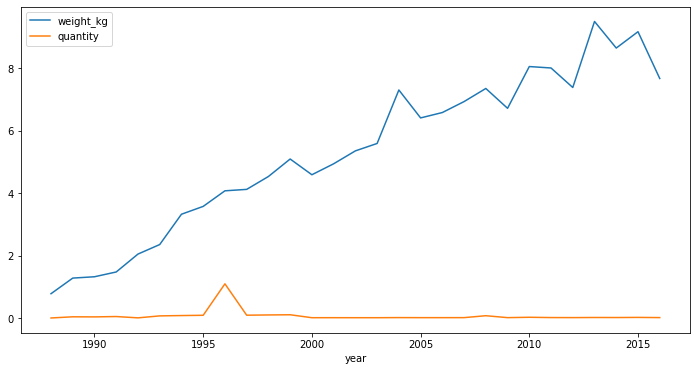

In [9]:
df_ie2.plot(figsize=(12,6))

In [10]:
from plotly.offline import init_notebook_mode, iplot
init_notebook_mode(connected=True)
import plotly.graph_objs as go
import plotly.offline as offline
offline.init_notebook_mode()
from plotly import tools
import warnings
warnings.filterwarnings('ignore')
import plotly.tools as tls
!pip install squarify
import squarify

temp1 = df_ie[['year', 'weight_kg']] 
temp2 = df_ie[['year', 'quantity']] 
# temp1 = gun[['state', 'n_killed']].reset_index(drop=True).groupby('state').sum()
# temp2 = gun[['state', 'n_injured']].reset_index(drop=True).groupby('state').sum()
trace1 = go.Bar(
    x=temp1.year,
    y=temp1.weight_kg,
    name = 'Year with Import/Export in terms of Weight (Kg.)'
)
trace2 = go.Bar(
    x=temp2.year,
    y=temp2.quantity,
    name = 'Year with Import/Export in terms of no. items (Quantity)'
)

fig = tools.make_subplots(rows=1, cols=2, subplot_titles=('Import/Export in terms of Weight (Kg.)', 'Year with Import/Export in terms of no. items (Quantity)'))
                                                          

fig.append_trace(trace1, 1, 1)
fig.append_trace(trace2, 1, 2)
                          
fig['layout']['xaxis1'].update(title='Year')
fig['layout']['xaxis2'].update(title='Year')

fig['layout']['yaxis1'].update(title='Year with Import/Export in terms of Weight (Kg.)')
fig['layout']['yaxis2'].update(title='Year with Import/Export in terms of no. items (Quantity)')
                          
fig['layout'].update(height=500, width=1500, title='Import/Export in terms of Weight(kg.) & No. of Items')
iplot(fig, filename='simple-subplot')

In [11]:
cnt_srs = data['flow'].value_counts()

trace = go.Bar(
    x=cnt_srs.index,
    y=cnt_srs.values,
    marker=dict(
        color=cnt_srs.values,
        colorscale = 'Picnic'
    ),
)

layout = go.Layout(
    title='Imports/Exports Ratio'
)

df = [trace]
fig = go.Figure(data=df, layout=layout)
offline.iplot(fig, filename="Ratio")

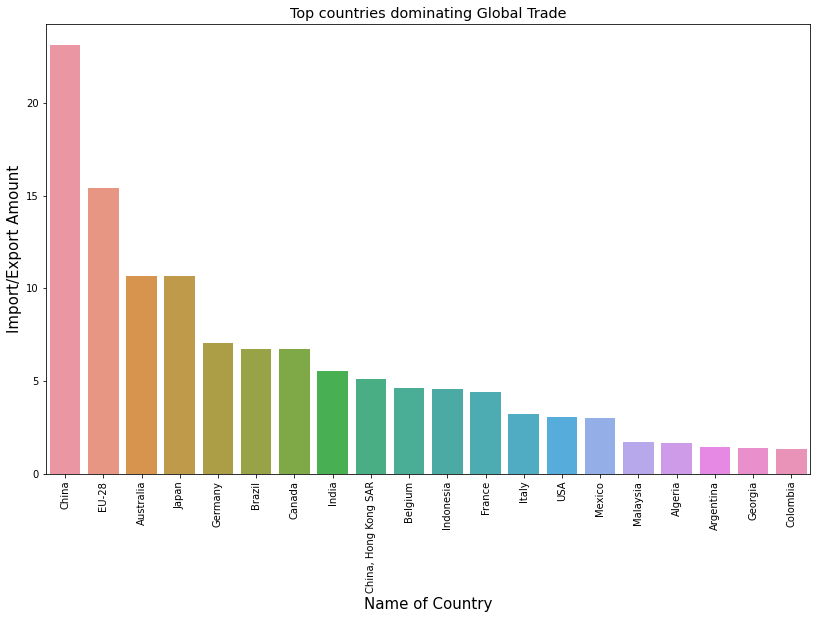

In [12]:
data_country=data.groupby(['country_or_area'],as_index=False)['weight_kg','quantity'].agg('sum')
data_country=data_country.sort_values(['weight_kg'],ascending=False)

fig, ax = plt.subplots()

fig.set_size_inches(13.7, 8.27)

sns.set_context("paper", font_scale=1.5)
f=sns.barplot(x=data_country["country_or_area"].head(20), y=data_country['weight_kg'].head(20), data=data_country)
f.set_xlabel("Name of Country",fontsize=15)
f.set_ylabel("Import/Export Amount",fontsize=15)
f.set_title('Top countries dominating Global Trade')
for item in f.get_xticklabels():
    item.set_rotation(90)

In [13]:
data_commodity=pd.concat([data['commodity'].str.split(', ', expand=True)], axis=1)

In [14]:
data_commodity.head()

,0,1,2,3,4,5,6
0,Sheep,live,None,None,None,None,None
1,Goats,live,None,None,None,None,None
2,Bovine animals,live pure-bred breeding,None,None,None,None,None
3,Bovine animals,live,except pure-bred breeding,None,None,None,None
4,Swine,live except pure-bred breeding > 50 kg,None,None,None,None,None


In [15]:
temp_series = data_commodity[0].value_counts().head(20)
labels = (np.array(temp_series.index))
sizes = (np.array((temp_series / temp_series.sum())*100))

trace = go.Pie(labels=labels, values=sizes)
layout = go.Layout(
    title='Top 20 Commodity Items to be Traded',
    width=900,
    height=900,
)
df = [trace]
fig = go.Figure(data=df, layout=layout)
offline.iplot(fig, filename="Commodity")

In [16]:
data_animals=data.loc[data['category']=='01_live_animals']
data_animals.head()

,Unnamed: 0,country_or_area,year,comm_code,commodity,flow,trade_usd,weight_kg,quantity_name,quantity,category,acat_code,unit_code
0,0,Afghanistan,2016,10410,"Sheep, live",Export,1.161273e-08,1.257437e-09,Number of items,4.969031e-14,01_live_animals,0,4
1,1,Afghanistan,2016,10420,"Goats, live",Export,7.549135e-09,5.289944e-10,Number of items,5.163895e-14,01_live_animals,0,4
2,2,Afghanistan,2008,10210,"Bovine animals, live pure-bred breeding",Import,1.958927e-06,1.462261e-10,Number of items,3.672212e-12,01_live_animals,0,4
3,3,Albania,2016,10290,"Bovine animals, live, except pure-bred breeding",Import,4.606426e-06,5.988942e-07,Number of items,6.677014e-12,01_live_animals,0,4
4,4,Albania,2016,10392,"Swine, live except pure-bred breeding > 50 kg",Import,2.721645e-05,5.099072e-06,Number of items,9.357368e-11,01_live_animals,0,4


In [17]:
data_animals['animal']=data_animals['commodity'].str.split(',').str[0]

cnt_srs = data_animals['animal'].value_counts()
trace = go.Bar(
    y=cnt_srs.index[::-1],
    x=cnt_srs.values[::-1],
    orientation = 'h',
    marker=dict(
        color=cnt_srs.values[::-1]
    ),
)

layout = dict(
    title='Animals Traded according to demand',
    )
df = [trace]
fig = go.Figure(data=df, layout=layout)
offline.iplot(fig, filename="Animals")

In [18]:
data['quantity_name'].unique()

array(['Number of items', 'Weight in kilograms', 'No Quantity',
       'Volume in litres', 'Length in metres', 'Area in square metres',
       'Electrical energy in thousands of kilowatt-hours',
       'Volume in cubic meters', 'Number of pairs', 'Thousands of items',
       'Weight in carats', 'Number of packages'], dtype=object)

In [19]:
data['quantity_name'].value_counts()

Weight in kilograms                                 6617980
Number of items                                      676412
No Quantity                                          200319
Volume in litres                                     142907
Area in square metres                                132088
Number of pairs                                       67086
Length in metres                                      17107
Volume in cubic meters                                16005
Weight in carats                                       3882
Thousands of items                                     1383
Number of packages                                     1039
Electrical energy in thousands of kilowatt-hours         75
Name: quantity_name, dtype: int64

<AxesSubplot:>

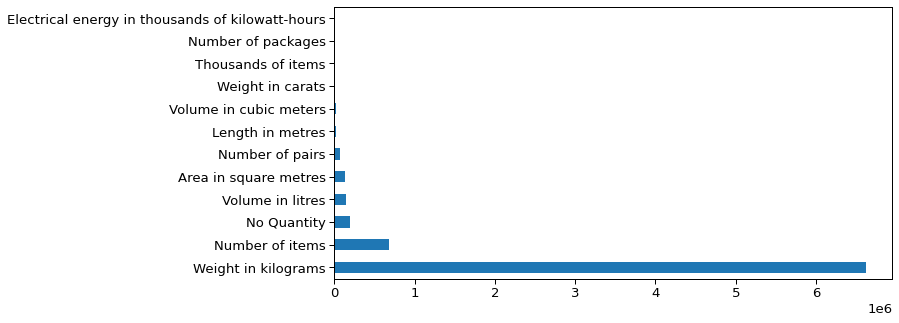

In [20]:
fig,ax=plt.subplots(figsize=(10,5))
data['quantity_name'].value_counts().plot(kind='barh')

In [66]:
df=data[['commodity','quantity_name','category','acat_code','unit_code']]
df1=data[['commodity','quantity_name','category','acat_code','unit_code']]
#df2=df.loc[data['quantity_name'] == 'Weight in kilograms'].sample(n=7000)
#df3=df.loc[data['quantity_name'] == 'Number of items'].sample(n=8000)
#df4=df.loc[data['quantity_name'] == 'No Quantity'].sample(n=7000)
#df5=df.loc[data['quantity_name'] == 'Volume in litres'].sample(n=9000)
#df6=df.loc[data['quantity_name'] == 'Area in square metres'].sample(n=9000)
#df7=df.loc[data['quantity_name'] == 'Number of pairs'].sample(n=9000)
df8=df.loc[data['quantity_name'] == 'Length in metres'].sample(n=5000)
df9=df.loc[data['quantity_name'] == 'Volume in cubic meters'].sample(n=2000)
##df10=df.loc[data['quantity_name'] == 'Weight in carats']
#df11=df.loc[data['quantity_name'] == 'Thousands of items']
#df12=df.loc[data['quantity_name'] == 'Number of packages']
#df13=df.loc[data['quantity_name'] == 'Electrical energy in thousands of kilowatt-hours']


In [22]:
df['quantity_name'].value_counts()

Weight in kilograms                                 6617980
Number of items                                      676412
No Quantity                                          200319
Volume in litres                                     142907
Area in square metres                                132088
Number of pairs                                       67086
Length in metres                                      17107
Volume in cubic meters                                16005
Weight in carats                                       3882
Thousands of items                                     1383
Number of packages                                     1039
Electrical energy in thousands of kilowatt-hours         75
Name: quantity_name, dtype: int64

In [67]:
#since our dataset contains all transaction flows from different countries many of the products will be repeated that's why we try to reduce the size of our data by droping the duplicated rows
df.drop_duplicates(inplace=True)
df=df.append(df1.sample(n=310000))
#df=df.append(df13)
#df=df.append(df2)
#df=df.append(df3)
##df=df.append(df4)
#df=df.append(df5)
#df=df.append(df6)
#df=df.append(df7)
df=df.append(df8)
df=df.append(df9)
##df=df.append(df10)
#df=df.append(df11)
#df=df.append(df12)

In [68]:
#df.reset_index(inplace=True)
df=df.loc[data['quantity_name'] != 'Electrical energy in thousands of kilowatt-hours']
df=df.loc[data['quantity_name'] != 'Weight in carats']

df

,commodity,quantity_name,category,acat_code,unit_code
0,"Sheep, live",Number of items,01_live_animals,0,4
1,"Goats, live",Number of items,01_live_animals,0,4
2,"Bovine animals, live pure-bred breeding",Number of items,01_live_animals,0,4
3,"Bovine animals, live, except pure-bred breeding",Number of items,01_live_animals,0,4
4,"Swine, live except pure-bred breeding > 50 kg",Number of items,01_live_animals,0,4
...,...,...,...,...,...
3702937,"Ties, railway or tramway, wood not impregnated",Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal,43,8
3703042,"Lumber, coniferous (softwood) thickness < 6 mm",Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal,43,8
3746809,"Logs, Oak (Quercus spp)",Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal,43,8
3714827,"Plywood, all softwood, each ply < 6mm thick",Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal,43,8


In [25]:
#df.to_csv('90.csv')

In [69]:
#final check for any missing data
df.isnull().sum()  

commodity        0
quantity_name    0
category         0
acat_code        0
unit_code        0
dtype: int64

In [27]:
#df['category'].unique()

In [28]:
#we check for the units that are used for our products 
df['quantity_name'].unique()

array(['Number of items', 'Weight in kilograms', 'No Quantity',
       'Volume in litres', 'Length in metres', 'Area in square metres',
       'Volume in cubic meters', 'Number of pairs', 'Thousands of items',
       'Number of packages'], dtype=object)

In [70]:
df['quantity_name'].value_counts()

Weight in kilograms       265481
Number of items            28771
No Quantity                12136
Length in metres            6091
Volume in litres            6010
Area in square metres       5691
Volume in cubic meters      2685
Number of pairs             2634
Thousands of items            44
Number of packages            40
Name: quantity_name, dtype: int64

In [ ]:
#df=df.loc[data['quantity_name'] != 'Number of packages']

In [30]:
#df.loc[df['quantity_name'].isin(['Electrical energy in thousands of kilowatt-hours','Number of packages','Thousands of items','Weight in carats','Volume in cubic meters','Length in metres','']),'quantity_name'] = 'other units'

<AxesSubplot:>

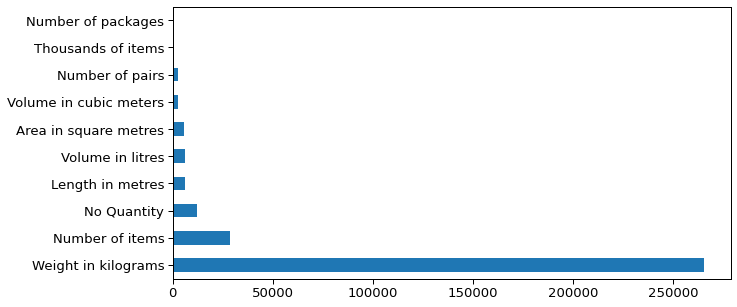

In [71]:
fig,ax=plt.subplots(figsize=(10,5))
df['quantity_name'].value_counts().plot(kind='barh')

<AxesSubplot:>

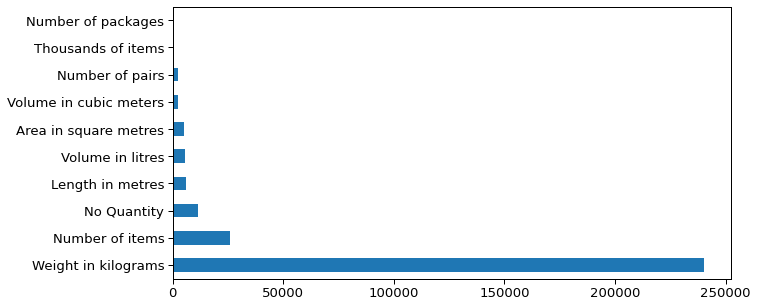

In [32]:
fig,ax=plt.subplots(figsize=(10,5))
df['quantity_name'].value_counts().plot(kind='barh')

In [72]:
df.reset_index(inplace=True)

In [73]:
df

,index,commodity,quantity_name,category,acat_code,unit_code
0,0,"Sheep, live",Number of items,01_live_animals,0,4
1,1,"Goats, live",Number of items,01_live_animals,0,4
2,2,"Bovine animals, live pure-bred breeding",Number of items,01_live_animals,0,4
3,3,"Bovine animals, live, except pure-bred breeding",Number of items,01_live_animals,0,4
4,4,"Swine, live except pure-bred breeding > 50 kg",Number of items,01_live_animals,0,4
...,...,...,...,...,...,...
329578,3702937,"Ties, railway or tramway, wood not impregnated",Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal,43,8
329579,3703042,"Lumber, coniferous (softwood) thickness < 6 mm",Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal,43,8
329580,3746809,"Logs, Oak (Quercus spp)",Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal,43,8
329581,3714827,"Plywood, all softwood, each ply < 6mm thick",Volume in cubic meters,44_wood_and_articles_of_wood_wood_charcoal,43,8


## preparing the data for product classification 

In [74]:
df['commodity'][16]

'Bovine animals, live pure-bred breeding'

In [36]:
#df['commodity_cat']=df['commodity']+'__'+df['category']

In [75]:
df=df[['commodity','quantity_name','unit_code']]

In [76]:
df

,commodity,quantity_name,unit_code
0,"Sheep, live",Number of items,4
1,"Goats, live",Number of items,4
2,"Bovine animals, live pure-bred breeding",Number of items,4
3,"Bovine animals, live, except pure-bred breeding",Number of items,4
4,"Swine, live except pure-bred breeding > 50 kg",Number of items,4
...,...,...,...
329578,"Ties, railway or tramway, wood not impregnated",Volume in cubic meters,8
329579,"Lumber, coniferous (softwood) thickness < 6 mm",Volume in cubic meters,8
329580,"Logs, Oak (Quercus spp)",Volume in cubic meters,8
329581,"Plywood, all softwood, each ply < 6mm thick",Volume in cubic meters,8


In [77]:
import string
import re
from nltk.corpus import stopwords
from nltk.stem import PorterStemmer
from nltk.tokenize import sent_tokenize, word_tokenize
import nltk
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.feature_extraction.text import TfidfTransformer
from sklearn.model_selection import train_test_split
from sklearn.pipeline import Pipeline
nltk.download('averaged_perceptron_tagger')
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import MultinomialNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import LinearSVC
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV

from sklearn.metrics import accuracy_score, classification_report

[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\utilisateur\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!


In [78]:
stop = stopwords.words('english')
print(stop[::10])

porter = PorterStemmer()

['i', "you've", 'himself', 'they', 'that', 'been', 'a', 'while', 'through', 'in', 'here', 'few', 'own', 'just', 're', 'doesn', 'ma', "shouldn't"]


In [79]:
def remove_punctuation(description):
    """The function to remove punctuation"""
    table = str.maketrans('', '', string.punctuation)
    return description.translate(table)

def remove_stopwords(text):
    """The function to removing stopwords"""
    text = [word.lower() for word in text.split() if word.lower() not in stop]
    return " ".join(text)

def stemmer(stem_text):
    """The function to apply stemming"""
    stem_text = [porter.stem(word) for word in stem_text.split()]
    return " ".join(stem_text)

In [80]:
df['commodity'] = df['commodity'].apply(remove_punctuation)
df['commodity'] = df['commodity'].apply(remove_stopwords)
df['commodity'] = df['commodity'].apply(stemmer)

In [81]:
df.head()

,commodity,quantity_name,unit_code
0,sheep live,Number of items,4
1,goat live,Number of items,4
2,bovin anim live purebr breed,Number of items,4
3,bovin anim live except purebr breed,Number of items,4
4,swine live except purebr breed 50 kg,Number of items,4


In [82]:
tokens = df['commodity'][0]

nltk.pos_tag(word_tokenize(tokens))

[('sheep', 'JJ'), ('live', 'NN')]

In [83]:
vectorizer = CountVectorizer()
vectorizer.fit(df['commodity'])
vector = vectorizer.transform(df['commodity'])
print(vector.shape)
print(vector.toarray())

(329583, 4075)
[[0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


In [84]:
# extract the tfid representation matrix of the text data
tfidf_converter = TfidfTransformer()
X_tfidf = tfidf_converter.fit_transform(vector).toarray()
X_tfidf

array([[0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       ...,
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.],
       [0., 0., 0., ..., 0., 0., 0.]])

In [85]:
X = df['commodity']
y = df['quantity_name']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state = 123)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((247187,), (82396,), (247187,), (82396,))

## SVC

In [86]:
svc = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',LinearSVC()),
               ])

svc.fit(X_train, y_train)

ytest = np.array(y_test)
y_pred = svc.predict(X_test)

print('accuracy %s' % accuracy_score(y_pred, ytest))
print(classification_report(ytest,y_pred))

accuracy 0.9010995679401913
                        precision    recall  f1-score   support

 Area in square metres       0.71      0.78      0.74      1407
      Length in metres       0.88      0.54      0.67      1526
           No Quantity       0.61      0.07      0.12      3067
       Number of items       0.71      0.89      0.79      7202
    Number of packages       0.43      1.00      0.61        10
       Number of pairs       0.73      0.97      0.84       624
    Thousands of items       0.44      1.00      0.62         8
Volume in cubic meters       0.85      1.00      0.92       677
      Volume in litres       0.95      0.59      0.73      1499
   Weight in kilograms       0.93      0.96      0.95     66376

              accuracy                           0.90     82396
             macro avg       0.73      0.78      0.70     82396
          weighted avg       0.90      0.90      0.89     82396



## Random forest

In [214]:
rf = Pipeline([('vect', CountVectorizer(min_df=5, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('rf', RandomForestClassifier(n_estimators=50)),
               ])

rf.fit(X_train, y_train)

ytest = np.array(y_test)
preds = rf.predict(X_test)

print('accuracy %s' % accuracy_score(preds, y_test))
print(classification_report(ytest, preds))

accuracy 0.8416785267606849
                       precision    recall  f1-score   support

Area in square metres       0.66      0.65      0.65       454
          No Quantity       0.38      0.04      0.07      1616
      Number of items       0.65      0.72      0.68      2314
      Number of pairs       0.69      0.91      0.78       170
     Volume in litres       0.88      0.54      0.67       447
  Weight in kilograms       0.88      0.95      0.91     17979
          other units       0.55      0.31      0.40       207

             accuracy                           0.84     23187
            macro avg       0.67      0.59      0.60     23187
         weighted avg       0.81      0.84      0.82     23187



## Naive Bayes

In [87]:
nbc = Pipeline([('vect', CountVectorizer(min_df=3, ngram_range=(1,2))),
               ('tfidf', TfidfTransformer()),
               ('model',MultinomialNB()),
               ])

nbc.fit(X_train, y_train)

ytest = np.array(y_test)
pred_y = nbc.predict(X_test)


print('accuracy %s' % accuracy_score(pred_y, y_test))
print(classification_report(ytest, pred_y))

accuracy 0.8732341375794942
                        precision    recall  f1-score   support

 Area in square metres       0.68      0.76      0.72      1407
      Length in metres       0.46      0.75      0.57      1526
           No Quantity       0.36      0.20      0.25      3067
       Number of items       0.69      0.87      0.77      7202
    Number of packages       0.00      0.00      0.00        10
       Number of pairs       0.70      0.95      0.81       624
    Thousands of items       0.00      0.00      0.00         8
Volume in cubic meters       0.84      0.95      0.89       677
      Volume in litres       0.58      0.79      0.67      1499
   Weight in kilograms       0.95      0.91      0.93     66376

              accuracy                           0.87     82396
             macro avg       0.53      0.62      0.56     82396
          weighted avg       0.88      0.87      0.87     82396



## Neural Networks

In [122]:
from sklearn.metrics import confusion_matrix

import tensorflow as tf
from tensorflow import keras
from keras.models import Sequential
from tensorflow.python.keras.layers import Dense, Flatten, Activation, Dropout, GlobalMaxPool1D, Conv1D
from tensorflow.python.keras.layers.embeddings import Embedding
from keras.preprocessing import text, sequence
from keras.preprocessing.text import Tokenizer
from tensorflow.keras.preprocessing.sequence import pad_sequences
from keras import utils

In [123]:
sentences = df['commodity']
y = df['quantity_name']
sentences_train, sentences_test, train_y, test_y = train_test_split(sentences, y, test_size=0.25, random_state=42)


In [124]:
tokenize = Tokenizer(num_words=1000)
tokenize.fit_on_texts(sentences_train)

X_train = tokenize.texts_to_sequences(sentences_train)
X_test = tokenize.texts_to_sequences(sentences_test)

vocab_size = len(tokenize.word_index) + 1  

print(sentences_train[3])
print(X_train[3])

bovin anim live except purebr breed
[269, 1, 541, 586]


In [125]:
maxlen = 20

X_train = pad_sequences(X_train, padding='post', maxlen=maxlen)
X_test = pad_sequences(X_test, padding='post', maxlen=maxlen)

print(X_train[0, :])

[336 158   2  75  19   0   0   0   0   0   0   0   0   0   0   0   0   0
   0   0]


In [126]:
encoder = LabelEncoder()
encoder.fit(train_y)
y_train = encoder.transform(train_y)
y_test = encoder.transform(test_y)

num_classes = np.max(y_train) + 1
y_train = utils.to_categorical(y_train, num_classes)
y_test = utils.to_categorical(y_test, num_classes)

In [96]:
embedding_dim = 16

model = Sequential()
model.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=maxlen))
model.add(Flatten())
model.add(Dense(16, activation='relu'))
model.add(Dense(10, activation='softmax'))

model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])
model.build(X_train.shape) 
model.summary()

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_8 (ModuleWra  (247187, 20, 16)         65424     
 pper)                                                           
                                                                 
 module_wrapper_9 (ModuleWra  (247187, 320)            0         
 pper)                                                           
                                                                 
 module_wrapper_10 (ModuleWr  (247187, 16)             5136      
 apper)                                                          
                                                                 
 module_wrapper_11 (ModuleWr  (247187, 10)             170       
 apper)                                                          
                                                                 
Total params: 70,730
Trainable params: 70,730
Non-trai

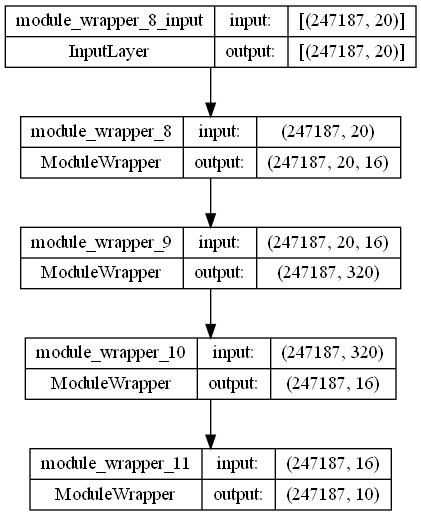

In [97]:
from keras.utils import plot_model
plot_model(model, to_file='model_1.png', show_shapes=True, show_layer_names=True)


In [98]:
history = model.fit(X_train, y_train,
                    batch_size=32,
                    epochs=15,
                    validation_data=(X_test, y_test))

Epoch 1/15
7725/7725 [==============================] - 9s 1ms/step - loss: 0.4251 - accuracy: 0.8751 - val_loss: 0.3718 - val_accuracy: 0.8852
Epoch 2/15
7725/7725 [==============================] - 8s 1ms/step - loss: 0.3604 - accuracy: 0.8886 - val_loss: 0.3646 - val_accuracy: 0.8874
Epoch 3/15
7725/7725 [==============================] - 9s 1ms/step - loss: 0.3531 - accuracy: 0.8901 - val_loss: 0.3620 - val_accuracy: 0.8870
Epoch 4/15
7725/7725 [==============================] - 9s 1ms/step - loss: 0.3495 - accuracy: 0.8910 - val_loss: 0.3585 - val_accuracy: 0.8890
Epoch 5/15
7725/7725 [==============================] - 10s 1ms/step - loss: 0.3475 - accuracy: 0.8917 - val_loss: 0.3591 - val_accuracy: 0.8895
Epoch 6/15
7725/7725 [==============================] - 8s 1ms/step - loss: 0.3460 - accuracy: 0.8922 - val_loss: 0.3582 - val_accuracy: 0.8901
Epoch 7/15
7725/7725 [==============================] - 9s 1ms/step - loss: 0.3448 - accuracy: 0.8922 - val_loss: 0.3631 - val_accuracy

In [99]:
loss, accuracy = model.evaluate(X_train, y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model.evaluate(X_test, y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))


Training Accuracy: 0.8946
Testing Accuracy:  0.8917


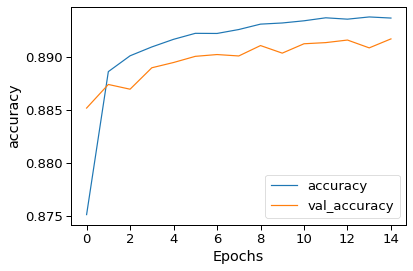

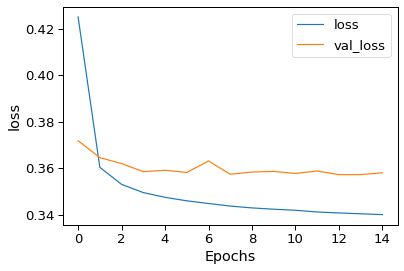

In [100]:
def plot_graphs(history, string):
    plt.plot(history.history[string])
    plt.plot(history.history['val_'+string])
    plt.xlabel("Epochs")
    plt.ylabel(string)
    plt.legend([string, 'val_'+string])
    plt.show()

plot_graphs(history, "accuracy")
plot_graphs(history, "loss")


In [101]:
embedding_dim = 50

model3 = Sequential()
model3.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=maxlen))
model3.add(GlobalMaxPool1D())
model3.add(Dense(16, activation='relu'))
model3.add(Dense(10, activation='softmax'))

model3.compile(optimizer='adam',
               loss='categorical_crossentropy',
               metrics=['accuracy'])
model3.build(X_train.shape) 
model3.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_12 (ModuleWr  (247187, 20, 50)         204450    
 apper)                                                          
                                                                 
 module_wrapper_13 (ModuleWr  (247187, 50)             0         
 apper)                                                          
                                                                 
 module_wrapper_14 (ModuleWr  (247187, 16)             816       
 apper)                                                          
                                                                 
 module_wrapper_15 (ModuleWr  (247187, 10)             170       
 apper)                                                          
                                                                 
Total params: 205,436
Trainable params: 205,436
Non-tr

In [102]:
history_3 = model3.fit(X_train, y_train,
                       batch_size=32,
                       epochs=15,
                       validation_data=(X_test, y_test))

Epoch 1/15
7725/7725 [==============================] - 12s 1ms/step - loss: 0.4480 - accuracy: 0.8711 - val_loss: 0.3705 - val_accuracy: 0.8855
Epoch 2/15
7725/7725 [==============================] - 11s 1ms/step - loss: 0.3596 - accuracy: 0.8887 - val_loss: 0.3626 - val_accuracy: 0.8874
Epoch 3/15
7725/7725 [==============================] - 11s 1ms/step - loss: 0.3528 - accuracy: 0.8906 - val_loss: 0.3585 - val_accuracy: 0.8884
Epoch 4/15
7725/7725 [==============================] - 12s 1ms/step - loss: 0.3489 - accuracy: 0.8920 - val_loss: 0.3562 - val_accuracy: 0.8902
Epoch 5/15
7725/7725 [==============================] - 12s 1ms/step - loss: 0.3466 - accuracy: 0.8925 - val_loss: 0.3572 - val_accuracy: 0.8904
Epoch 6/15
7725/7725 [==============================] - 12s 2ms/step - loss: 0.3450 - accuracy: 0.8927 - val_loss: 0.3546 - val_accuracy: 0.8915
Epoch 7/15
7725/7725 [==============================] - 12s 2ms/step - loss: 0.3436 - accuracy: 0.8931 - val_loss: 0.3546 - val_ac

In [103]:
loss3, accuracy3 = model3.evaluate(X_train, y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model3.evaluate(X_test, y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))


Training Accuracy: 0.8917
Testing Accuracy:  0.8921


In [61]:
df['quantity_name'].value_counts()

Weight in kilograms                                 55379
Number of items                                      7333
No Quantity                                          5731
Area in square metres                                1480
Volume in litres                                     1438
Number of pairs                                       640
Length in metres                                      550
Volume in cubic meters                                148
Weight in carats                                       32
Thousands of items                                     11
Number of packages                                      5
Electrical energy in thousands of kilowatt-hours        1
Name: quantity_name, dtype: int64

In [104]:
embedding_dim = 50

model5 = Sequential()
model5.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=maxlen))
model5.add(Conv1D(128, 5, activation='relu'))
model5.add(GlobalMaxPool1D())
model5.add(Dense(16, activation='relu'))
model5.add(Dense(10, activation='softmax'))

model5.compile(optimizer='adam',
               loss='categorical_crossentropy',
               metrics=['accuracy'])
model5.build(X_train.shape) 
model5.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_16 (ModuleWr  (247187, 20, 50)         204450    
 apper)                                                          
                                                                 
 module_wrapper_17 (ModuleWr  (247187, 16, 128)        32128     
 apper)                                                          
                                                                 
 module_wrapper_18 (ModuleWr  (247187, 128)            0         
 apper)                                                          
                                                                 
 module_wrapper_19 (ModuleWr  (247187, 16)             2064      
 apper)                                                          
                                                                 
 module_wrapper_20 (ModuleWr  (247187, 10)            

In [105]:
history_5 = model5.fit(X_train, y_train,
                       batch_size=50,
                       epochs=10,
                       validation_data=(X_test, y_test))

Epoch 1/10
4944/4944 [==============================] - 15s 3ms/step - loss: 0.4088 - accuracy: 0.8794 - val_loss: 0.3662 - val_accuracy: 0.8884
Epoch 2/10
4944/4944 [==============================] - 15s 3ms/step - loss: 0.3551 - accuracy: 0.8907 - val_loss: 0.3620 - val_accuracy: 0.8883
Epoch 3/10
4944/4944 [==============================] - 16s 3ms/step - loss: 0.3493 - accuracy: 0.8919 - val_loss: 0.3564 - val_accuracy: 0.8900
Epoch 4/10
4944/4944 [==============================] - 16s 3ms/step - loss: 0.3462 - accuracy: 0.8931 - val_loss: 0.3576 - val_accuracy: 0.8909
Epoch 5/10
4944/4944 [==============================] - 16s 3ms/step - loss: 0.3445 - accuracy: 0.8933 - val_loss: 0.3551 - val_accuracy: 0.8904
Epoch 6/10
4944/4944 [==============================] - 16s 3ms/step - loss: 0.3425 - accuracy: 0.8934 - val_loss: 0.3565 - val_accuracy: 0.8919
Epoch 7/10
4944/4944 [==============================] - 17s 3ms/step - loss: 0.3416 - accuracy: 0.8935 - val_loss: 0.3563 - val_ac

In [106]:
loss, accuracy = model5.evaluate(X_train, y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model5.evaluate(X_test, y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))

Training Accuracy: 0.8949
Testing Accuracy:  0.8916


In [107]:
pred = model.predict(X_test[:])
print(pred)

2575/2575 [==============================] - 2s 602us/step
[[4.1926574e-02 1.7920345e-01 1.9660046e-02 ... 6.7679698e-20
  4.6316450e-06 7.5896198e-01]
 [2.0833731e-06 1.0157729e-07 1.8592274e-02 ... 1.7379243e-24
  7.3400690e-05 9.8126799e-01]
 [8.3471807e-03 6.5714471e-02 1.4799520e-02 ... 7.0155890e-26
  2.8377920e-07 9.1106367e-01]
 ...
 [5.1440791e-05 4.2246161e-06 2.6217477e-02 ... 1.2932350e-19
  2.6629027e-06 9.7298592e-01]
 [8.2550170e-03 1.4404442e-02 2.2925498e-02 ... 1.9115972e-17
  7.3352976e-06 9.5244879e-01]
 [7.8940311e-06 1.8271356e-05 6.2630802e-02 ... 5.4761200e-30
  9.9456952e-07 9.3679649e-01]]


In [108]:
p=np.argmax(pred,axis=1)
print(p[:15])
y_test=np.argmax(y_test, axis=1)
print(y_test[:15])

[9 9 9 9 1 9 3 9 9 9 9 9 9 9 9]
[9 9 9 9 2 9 3 9 9 9 9 9 9 9 9]


In [109]:
predictions = p
predictions = predictions.reshape(1,-1)[0]
predictions[:15]

array([9, 9, 9, 9, 1, 9, 3, 9, 9, 9, 9, 9, 9, 9, 9], dtype=int64)

array([[198, 160,   9, ...,   0,   0,   0],
       [137, 276,   0, ...,   0,   0,   0],
       [583,  13, 189, ...,   0,   0,   0],
       ...,
       [480, 148,   0, ...,   0,   0,   0],
       [179,  85,  13, ...,   0,   0,   0],
       [148, 525,   1, ...,   0,   0,   0]])

In [112]:
print(classification_report(y_test, predictions))

              precision    recall  f1-score   support

           0       0.69      0.78      0.74      1422
           1       0.87      0.55      0.68      1545
           2       0.63      0.03      0.06      3023
           3       0.71      0.80      0.75      7150
           4       0.35      1.00      0.52         6
           5       0.74      0.94      0.83       670
           6       0.68      1.00      0.81        15
           7       0.86      0.93      0.89       665
           8       0.95      0.47      0.63      1543
           9       0.92      0.96      0.94     66357

    accuracy                           0.89     82396
   macro avg       0.74      0.75      0.68     82396
weighted avg       0.89      0.89      0.88     82396



<AxesSubplot:>

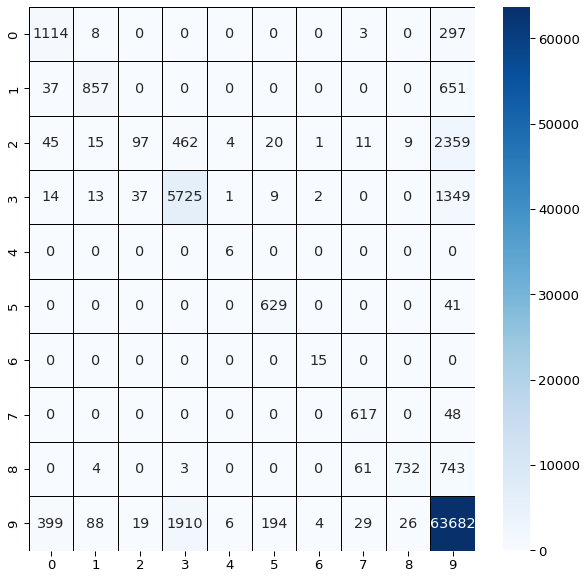

In [111]:
cm = confusion_matrix(y_test,predictions)
plt.figure(figsize = (10,10))
sns.heatmap(cm,cmap= "Blues", linecolor = 'black' , linewidth = 1 , annot = True, fmt='')

In [65]:
df.loc[df['quantity_name'].isin(['Electrical energy in thousands of kilowatt-hours','Weight in carats','Number of packages',]),'quantity_name'] = 'other'

In [66]:
df['quantity_name'].unique()

array(['Number of items', 'Weight in kilograms', 'No Quantity',
       'Volume in litres', 'Length in metres', 'Area in square metres',
       'other', 'Volume in cubic meters', 'Number of pairs',
       'Thousands of items'], dtype=object)

In [127]:
embedding_dim = 50

model6 = Sequential()
model6.add(Embedding(input_dim=vocab_size, output_dim=embedding_dim, input_length=maxlen))
model6.add(Conv1D(256, 5, activation='relu'))
model6.add(GlobalMaxPool1D())
model6.add(Dense(12, activation='relu'))
model6.add(Dense(10, activation='softmax'))

model6.compile(optimizer='adam',
               loss='categorical_crossentropy',
               metrics=['accuracy'])
model6.build(X_train.shape) 
model6.summary()

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_36 (ModuleWr  (247187, 20, 50)         204450    
 apper)                                                          
                                                                 
 module_wrapper_37 (ModuleWr  (247187, 16, 256)        64256     
 apper)                                                          
                                                                 
 module_wrapper_38 (ModuleWr  (247187, 256)            0         
 apper)                                                          
                                                                 
 module_wrapper_39 (ModuleWr  (247187, 12)             3084      
 apper)                                                          
                                                                 
 module_wrapper_40 (ModuleWr  (247187, 10)            

In [128]:
history_6 = model6.fit(X_train, y_train,
                       batch_size=32,
                       epochs=15,
                       validation_data=(X_test, y_test))

Epoch 1/15
7725/7725 [==============================] - 24s 3ms/step - loss: 0.4332 - accuracy: 0.8743 - val_loss: 0.3863 - val_accuracy: 0.8836
Epoch 2/15
7725/7725 [==============================] - 25s 3ms/step - loss: 0.3720 - accuracy: 0.8881 - val_loss: 0.3811 - val_accuracy: 0.8857
Epoch 3/15
7725/7725 [==============================] - 25s 3ms/step - loss: 0.3641 - accuracy: 0.8901 - val_loss: 0.3687 - val_accuracy: 0.8885
Epoch 4/15
7725/7725 [==============================] - 25s 3ms/step - loss: 0.3599 - accuracy: 0.8908 - val_loss: 0.3664 - val_accuracy: 0.8907
Epoch 5/15
7725/7725 [==============================] - 26s 3ms/step - loss: 0.3573 - accuracy: 0.8916 - val_loss: 0.3651 - val_accuracy: 0.8901
Epoch 6/15
7725/7725 [==============================] - 26s 3ms/step - loss: 0.3555 - accuracy: 0.8922 - val_loss: 0.3680 - val_accuracy: 0.8878
Epoch 7/15
7725/7725 [==============================] - 28s 4ms/step - loss: 0.3541 - accuracy: 0.8926 - val_loss: 0.3694 - val_ac

In [129]:
loss, accuracy = model6.evaluate(X_train, y_train, verbose=False)
print("Training Accuracy: {:.4f}".format(accuracy))
loss, accuracy = model6.evaluate(X_test, y_test, verbose=False)
print("Testing Accuracy:  {:.4f}".format(accuracy))

Training Accuracy: 0.8945
Testing Accuracy:  0.8913


In [130]:
data

,Unnamed: 0,country_or_area,year,comm_code,commodity,flow,trade_usd,weight_kg,quantity_name,quantity,category,acat_code,unit_code
0,0,Afghanistan,2016,10410,"Sheep, live",Export,1.161273e-08,1.257437e-09,Number of items,4.969031e-14,01_live_animals,0,4
1,1,Afghanistan,2016,10420,"Goats, live",Export,7.549135e-09,5.289944e-10,Number of items,5.163895e-14,01_live_animals,0,4
2,2,Afghanistan,2008,10210,"Bovine animals, live pure-bred breeding",Import,1.958927e-06,1.462261e-10,Number of items,3.672212e-12,01_live_animals,0,4
3,3,Albania,2016,10290,"Bovine animals, live, except pure-bred breeding",Import,4.606426e-06,5.988942e-07,Number of items,6.677014e-12,01_live_animals,0,4
4,4,Albania,2016,10392,"Swine, live except pure-bred breeding > 50 kg",Import,2.721645e-05,5.099072e-06,Number of items,9.357368e-11,01_live_animals,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...
7876278,8225123,Tunisia,1995,TOTAL,ALL COMMODITIES,Export,1.044445e-02,0.000000e+00,No Quantity,0.000000e+00,all_commodities,97,3
7876279,8225460,United Kingdom,1998,TOTAL,ALL COMMODITIES,Import,5.950014e-01,0.000000e+00,No Quantity,0.000000e+00,all_commodities,97,3
7876280,8225461,United Kingdom,1998,TOTAL,ALL COMMODITIES,Export,5.156674e-01,0.000000e+00,No Quantity,0.000000e+00,all_commodities,97,3
7876281,8225462,United Kingdom,1997,TOTAL,ALL COMMODITIES,Import,5.821351e-01,0.000000e+00,No Quantity,0.000000e+00,all_commodities,97,3


In [133]:
data=data.iloc[:,1:]

In [134]:
data.head(5)

,country_or_area,year,comm_code,commodity,flow,trade_usd,weight_kg,quantity_name,quantity,category,acat_code,unit_code
0,Afghanistan,2016,10410,"Sheep, live",Export,1.161273e-08,1.257437e-09,Number of items,4.969031e-14,01_live_animals,0,4
1,Afghanistan,2016,10420,"Goats, live",Export,7.549135e-09,5.289944e-10,Number of items,5.163895e-14,01_live_animals,0,4
2,Afghanistan,2008,10210,"Bovine animals, live pure-bred breeding",Import,1.958927e-06,1.462261e-10,Number of items,3.672212e-12,01_live_animals,0,4
3,Albania,2016,10290,"Bovine animals, live, except pure-bred breeding",Import,4.606426e-06,5.988942e-07,Number of items,6.677014e-12,01_live_animals,0,4
4,Albania,2016,10392,"Swine, live except pure-bred breeding > 50 kg",Import,2.721645e-05,5.099072e-06,Number of items,9.357368e-11,01_live_animals,0,4


## Product clustering

In [135]:
dat=data.sample(n=90000)

In [136]:
dat.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 90000 entries, 6838872 to 5608462
Data columns (total 12 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   country_or_area  90000 non-null  object 
 1   year             90000 non-null  int64  
 2   comm_code        90000 non-null  object 
 3   commodity        90000 non-null  object 
 4   flow             90000 non-null  object 
 5   trade_usd        90000 non-null  float64
 6   weight_kg        90000 non-null  float64
 7   quantity_name    90000 non-null  object 
 8   quantity         90000 non-null  float64
 9   category         90000 non-null  object 
 10  acat_code        90000 non-null  int64  
 11  unit_code        90000 non-null  int32  
dtypes: float64(3), int32(1), int64(2), object(6)
memory usage: 8.6+ MB


In [137]:
from sklearn.preprocessing import MinMaxScaler, scale
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.metrics import silhouette_score, classification_report
from pyclustertend import hopkins,vat
import scipy.cluster.hierarchy as sch
import yellowbrick
from yellowbrick.cluster import KElbowVisualizer

In [138]:
dat=dat.loc[data['comm_code'] != '9999AA']
dat=dat.loc[data['comm_code'] != 'TOTAL']

In [139]:
dat

,country_or_area,year,comm_code,commodity,flow,trade_usd,weight_kg,quantity_name,quantity,category,acat_code,unit_code
6838872,Indonesia,2012,830990,"Stoppers, caps, lids, packing items nes of bas...",Export,6.388313e-05,3.937968e-06,Weight in kilograms,7.137034e-09,83_miscellaneous_articles_of_base_metal,81,11
5705198,Austria,2000,691090,Ceramic bathroom kitchen sanitary items not po...,Import,3.265094e-05,3.199403e-06,Number of items,7.097891e-10,69_ceramic_products,68,4
4299465,Chile,2001,520959,"Woven cotton nes, >85% >200g/m2, printed, nes",Import,1.178577e-07,3.564798e-09,Weight in kilograms,6.460715e-12,52_cotton,51,11
3594582,Guyana,2008,420330,Belts and bandoliers of leather or composition...,Export,1.088205e-08,8.386496e-10,Weight in kilograms,1.519939e-12,42_articles_of_leather_animal_gut_harness_trav...,41,11
5469119,Angola,2015,650100,"Hat-forms, etc of felt, not shaped, no formed ...",Import,2.522102e-09,1.317110e-10,Weight in kilograms,2.387084e-13,65_headgear_and_parts_thereof,64,11
...,...,...,...,...,...,...,...,...,...,...,...,...
6062504,Brunei Darussalam,2004,722880,Hollow drill bars and rods of alloy/non-alloy ...,Import,1.509522e-07,2.910383e-08,Weight in kilograms,5.274675e-11,72_iron_and_steel,71,11
3457858,Bulgaria,2008,410130,"Bovine hides, raw, nes",Re-Import,5.866462e-09,4.838363e-12,Weight in kilograms,8.768879e-15,41_raw_hides_and_skins_other_than_furskins_and...,40,11
5063524,Saint Lucia,2004,600242,"Warp knit fabric of cotton, nes",Import,3.966950e-07,2.758512e-08,Weight in kilograms,4.999430e-11,60_knitted_or_crocheted_fabric,59,11
1859442,Chile,2009,230610,Cotton seed oil-cake and other solid residues,Import,1.250634e-06,1.347932e-06,Weight in kilograms,2.442945e-09,23_residues_wastes_of_food_industry_animal_fodder,22,11


In [140]:
dat['comm_code']=pd.to_numeric(dat['comm_code'])
dat=dat[['comm_code','trade_usd','weight_kg','quantity','acat_code']]

In [141]:

dat

,comm_code,trade_usd,weight_kg,quantity,acat_code
6838872,830990,6.388313e-05,3.937968e-06,7.137034e-09,81
5705198,691090,3.265094e-05,3.199403e-06,7.097891e-10,68
4299465,520959,1.178577e-07,3.564798e-09,6.460715e-12,51
3594582,420330,1.088205e-08,8.386496e-10,1.519939e-12,41
5469119,650100,2.522102e-09,1.317110e-10,2.387084e-13,64
...,...,...,...,...,...
6062504,722880,1.509522e-07,2.910383e-08,5.274675e-11,71
3457858,410130,5.866462e-09,4.838363e-12,8.768879e-15,40
5063524,600242,3.966950e-07,2.758512e-08,4.999430e-11,59
1859442,230610,1.250634e-06,1.347932e-06,2.442945e-09,22


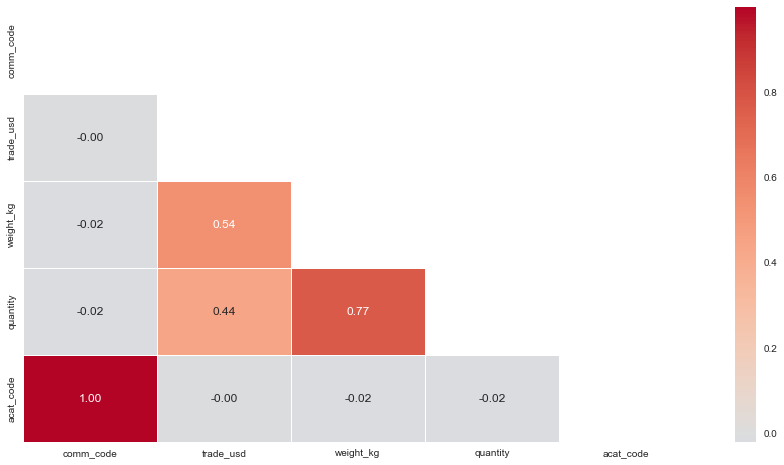

In [142]:
corr = dat.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
# Draw the heatmap
fig, ax = plt.subplots(figsize=(15,8))
sns.heatmap(corr, mask=mask,  cmap="coolwarm", center=0, linewidths=1, annot=True, fmt=".2f")
plt.show()

In [143]:
dat.describe().T

,count,mean,std,min,25%,50%,75%,max
comm_code,89983.0,4.783353e+05,275104.825086,10111.0,2.403990e+05,4.818200e+05,7.108110e+05,970600.000000
trade_usd,89983.0,3.752840e-05,0.000720,0.0,2.167539e-08,2.982986e-07,3.583385e-06,0.141601
weight_kg,89983.0,1.530906e-05,0.000539,0.0,6.195793e-10,1.497043e-08,2.474038e-07,0.061626
quantity,89983.0,3.193155e-08,0.000001,0.0,1.067367e-12,2.630274e-11,4.424971e-10,0.000240
acat_code,89983.0,4.657061e+01,27.235303,0.0,2.300000e+01,4.700000e+01,7.000000e+01,95.000000


In [144]:
hopkins(scale(dat),dat.shape[0])

0.0001693752221209203

In [145]:
def find_k(range_n_clusters):
    ssd = []
    silhoutte_scores = []

    for num_clusters in range_n_clusters:
        kmeans = KMeans(n_clusters=num_clusters, max_iter=50)
        kmeans.fit(dat)
        labels=kmeans.predict(dat)
        silhouette = silhouette_score(dat,labels)
        silhoutte_scores.append(silhouette)
        ssd.append(kmeans.inertia_)
    
    fig, axs = plt.subplots(1, 2, figsize=(10,5))
    
    axs[0].plot(ssd)
    axs[0].set_xlabel('K Value')
    axs[0].set_ylabel('Inertia')

    axs[1].plot(silhoutte_scores)
    axs[1].set_xlabel('K Value')
    axs[1].set_ylabel('Silhouette Scores')
    
    plt.tight_layout()

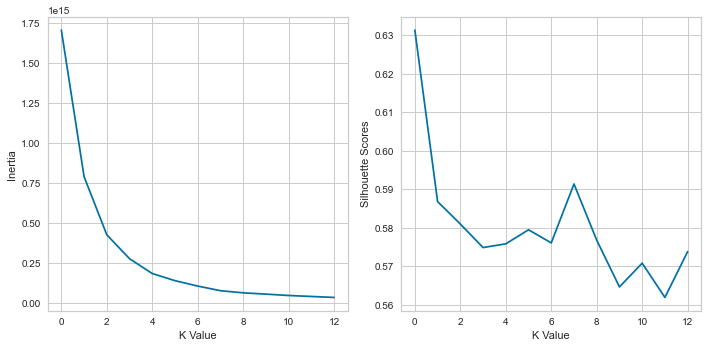

In [146]:
find_k([2, 3, 4, 5, 6, 7, 8, 9, 10, 11,12,13,14])

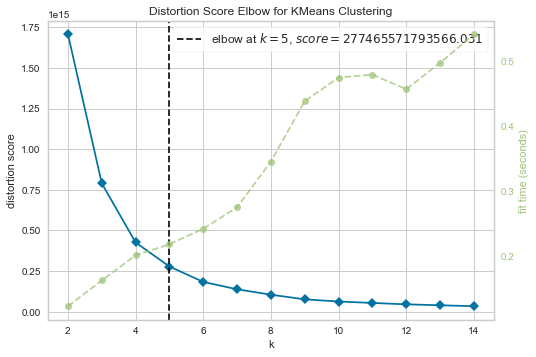

<AxesSubplot:title={'center':'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [147]:
kmeans = KMeans()
visualizer = KElbowVisualizer(kmeans, k=(2,15))
visualizer.fit(dat)
visualizer.show()

In [148]:
kmeans = KMeans(n_clusters=7,random_state=40)
kmeans.fit(dat)
kmeans.cluster_centers_

array([[5.73446439e+05, 1.40013334e-05, 6.19981280e-07, 1.55122057e-09,
        5.62831892e+01],
       [1.88636292e+05, 3.05037676e-05, 8.20225153e-06, 4.29917742e-08,
        1.78124827e+01],
       [8.85086610e+05, 4.19188434e-05, 1.33890832e-06, 4.24780634e-09,
        8.64044465e+01],
       [4.26713961e+05, 2.83911088e-05, 6.20897350e-06, 1.10354062e-08,
        4.15911313e+01],
       [6.83379920e+04, 3.03039772e-05, 1.50949531e-05, 2.88359831e-08,
        5.77308842e+00],
       [7.19967458e+05, 3.19658258e-05, 4.78893299e-06, 8.80229442e-09,
        7.08021676e+01],
       [3.03258664e+05, 8.94746170e-05, 7.69430485e-05, 1.41201383e-07,
        2.92252449e+01]])

In [149]:
preds = kmeans.predict(dat)
preds

array([2, 5, 0, ..., 0, 1, 5])

In [150]:
silhouette_score(dat,preds)

0.5788911964990124

In [151]:
dat['class'] = preds

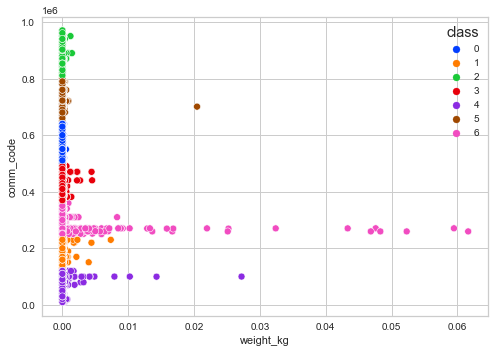

In [152]:
sns.scatterplot(data=dat,x='weight_kg',y='comm_code',hue='class',palette='bright');

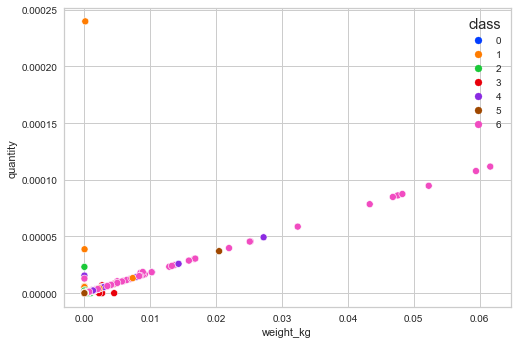

In [153]:
sns.scatterplot(data=dat,x='weight_kg',y='quantity',hue='class',palette='bright');

In [154]:
import plotly.express as px

  
fig = px.scatter_3d(dat, x = 'weight_kg', 
                    y = 'quantity', 
                    z = 'comm_code',
                    color = 'class')
  
fig.show()

In [155]:
fig2 = px.scatter_3d(dat, x = 'weight_kg', 
                    y = 'comm_code', 
                    z = 'trade_usd',
                    color = 'class')
  
fig2.show()

##  regression

In [201]:
Y= data['quantity'].values
X=data[['trade_usd','weight_kg','acat_code']].values
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size=0.20, random_state = 123)

In [202]:
Y_test

array([2.43579963e-14, 2.58991189e-08, 3.23220673e-09, ...,
       3.21994706e-08, 2.97479337e-11, 2.18120985e-11])

In [203]:
# Take a single example of X
input_shape = X_train[0].shape 

# Take a single example of y
output_shape = Y_train[0].shape

input_shape, output_shape 

((3,), ())

In [207]:
from sklearn.metrics import mean_squared_error,mean_absolute_error
from tensorflow.keras.callbacks import TensorBoard
model = Sequential()
model.add(Dense(20, input_dim=X_train.shape[1], activation="relu"))
model.add(Dense(15, activation="relu"))
model.add(Dense(1))

model.compile(loss="mean_squared_error" , optimizer="adam", metrics=["mean_squared_error"])
history = model.fit(X_train ,Y_train, epochs=10, verbose=1)

Epoch 1/10
196908/196908 [==============================] - 156s 788us/step - loss: 7.8733e-05 - mean_squared_error: 7.8733e-05
Epoch 2/10
196908/196908 [==============================] - 158s 801us/step - loss: 1.6907e-07 - mean_squared_error: 1.6907e-07
Epoch 3/10
196908/196908 [==============================] - 155s 789us/step - loss: 1.6907e-07 - mean_squared_error: 1.6907e-07
Epoch 4/10
196908/196908 [==============================] - 158s 802us/step - loss: 1.6917e-07 - mean_squared_error: 1.6917e-07
Epoch 5/10
196908/196908 [==============================] - 160s 812us/step - loss: 1.6898e-07 - mean_squared_error: 1.6898e-07
Epoch 6/10
196908/196908 [==============================] - 161s 818us/step - loss: 1.6916e-07 - mean_squared_error: 1.6916e-07
Epoch 7/10
196908/196908 [==============================] - 160s 815us/step - loss: 1.6901e-07 - mean_squared_error: 1.6901e-07
Epoch 8/10
196908/196908 [==============================] - 161s 817us/step - loss: 1.6906e-07 - mean_sq

In [208]:
model.summary()

Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 module_wrapper_62 (ModuleWr  (None, 20)               80        
 apper)                                                          
                                                                 
 module_wrapper_63 (ModuleWr  (None, 15)               315       
 apper)                                                          
                                                                 
 module_wrapper_64 (ModuleWr  (None, 1)                16        
 apper)                                                          
                                                                 
Total params: 411
Trainable params: 411
Non-trainable params: 0
_________________________________________________________________


In [209]:
mean_squared_error(model.predict(X_test), Y_test)

49227/49227 [==============================] - 30s 610us/step


9.127713656873561e-09

In [210]:
mean_absolute_error(model.predict(X_test),Y_test)

49227/49227 [==============================] - 31s 619us/step


2.6450146298967587e-07

In [211]:
X_test

array([[3.24324747e-11, 1.34398974e-11, 3.70000000e+01],
       [3.48084110e-05, 1.42902355e-05, 1.80000000e+01],
       [2.95203055e-06, 1.78341956e-06, 1.40000000e+01],
       ...,
       [2.22485460e-05, 1.77665509e-05, 3.00000000e+01],
       [8.02398501e-08, 1.64138780e-08, 1.50000000e+01],
       [1.11508571e-07, 1.20351594e-08, 7.50000000e+01]])

In [212]:
Y_test

array([2.43579963e-14, 2.58991189e-08, 3.23220673e-09, ...,
       3.21994706e-08, 2.97479337e-11, 2.18120985e-11])

In [213]:
pred = model.predict(X_test)
print(pred)

49227/49227 [==============================] - 30s 617us/step
[[-7.5611936e-08]
 [-7.5611936e-08]
 [-7.5611936e-08]
 ...
 [-7.5611936e-08]
 [-7.5611936e-08]
 [-7.5611936e-08]]


[1290]


IndexError: invalid index to scalar variable.

1290